In [1]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.patches as patches

import os
os.chdir("/Users/deweywang/Desktop/GitHub/HEVisum/")


# Training data preparation 

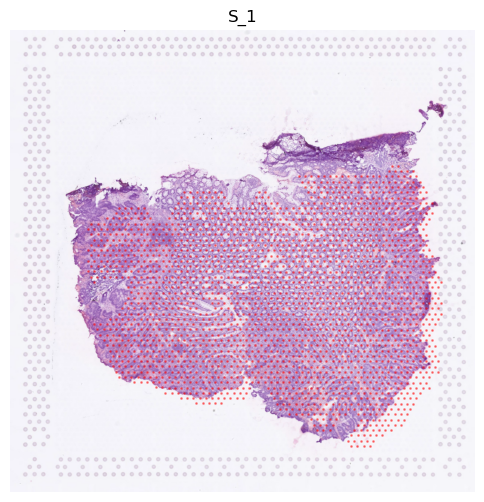

In [220]:
with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    train_spots = h5file["spots/Train"]
    
    sample = 'S_1'
    image = np.array(train_images[sample])
    spots = np.array(train_spots[sample])
    x, y = spots["x"], spots["y"]
    
    plt.figure(figsize=(6,6))
    plt.imshow(image, aspect="auto")
    plt.scatter(x, y, color="red", s=1, alpha=0.4)
    plt.axis('off')
    plt.title(sample)
    plt.show()

## Training data augmentation

In [45]:

# Load and display (x,y) spot locations and cell type annotation table for Train slides
with h5py.File("./dataset/processed_train_spots.h5", "r") as f:
    train_spots = f["spots/log2_Train"]
    
    # Dictionary to store DataFrames for each slide
    train_spot_tables = {}
    
    for slide_name in train_spots.keys():
        # Load dataset as NumPy structured array
        spot_array = np.array(train_spots[slide_name])
        
        # Convert to DataFrame
        df = pd.DataFrame(spot_array)
        
        # Store in dictionary
        train_spot_tables[slide_name] = df
        print(slide_name)

# Example: Display the spots table for slide 'S_1'
train_spot_tables['S_1']

S_1
S_2
S_3
S_4
S_5
S_6


,x,y,zscore_log2_filtered_C1,zscore_log2_filtered_C2,zscore_log2_filtered_C3,zscore_log2_filtered_C4,zscore_log2_filtered_C5,zscore_log2_filtered_C6,zscore_log2_filtered_C7,zscore_log2_filtered_C8,...,zscore_log2_filtered_C26,zscore_log2_filtered_C27,zscore_log2_filtered_C28,zscore_log2_filtered_C29,zscore_log2_filtered_C30,zscore_log2_filtered_C31,zscore_log2_filtered_C32,zscore_log2_filtered_C33,zscore_log2_filtered_C34,zscore_log2_filtered_C35
0,1554,1297,-0.682399,-0.486604,-0.675375,-0.630631,-0.087697,1.867268,-0.582425,1.972258,...,-0.608880,1.889307,1.962398,-0.394728,-0.623269,-0.573923,-0.509936,1.942483,-0.648011,-0.034259
1,462,1502,-0.494081,0.851039,-0.446648,-0.454476,2.485569,-0.548122,1.116866,-0.458160,...,-0.635557,-0.508851,-0.680085,0.300420,-0.622258,1.222955,0.292557,-0.419384,-0.515263,-0.043962
2,1488,1548,-0.464161,-0.709324,-0.571479,-0.624617,0.471550,-0.513574,-0.716618,-0.709200,...,-0.685620,0.704991,-0.579491,-0.674142,-0.624744,-0.708489,-0.730628,-0.410204,-0.700551,-0.639972
3,1725,1182,-0.544981,1.188377,-0.497213,-0.577362,2.485569,1.352764,2.285996,0.862122,...,-0.528791,0.643741,-0.524663,1.241803,-0.622460,0.875722,1.469540,-0.439801,-0.629313,1.063659
4,581,1113,-0.472547,-0.396244,-0.475592,-0.435909,1.786346,-0.637150,-0.331702,-0.653593,...,-0.687626,-0.590609,-0.696491,-0.436046,-0.522004,-0.405082,-0.558152,-0.670901,-0.716521,-0.679859
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2144,1055,701,-0.619665,0.062232,-0.594557,-0.628926,-0.842855,1.867268,0.060022,1.368926,...,-0.063283,1.889307,1.962398,1.966633,-0.623938,-0.422312,0.441354,-0.475778,-0.472820,1.260253
2145,1225,862,-0.575912,0.125898,-0.247509,-0.632671,-0.837670,1.867268,-0.099108,-0.087897,...,1.920233,1.889307,1.962398,1.966633,-0.624690,-0.427876,0.519453,1.081671,0.095768,2.245422
2146,765,1479,-0.360575,-0.583202,-0.350557,-0.625037,-0.645280,-0.649256,-0.801054,-0.714806,...,-0.671584,-0.645177,-0.698742,-0.702498,-0.618830,-0.655168,-0.715474,-0.675282,-0.715874,-0.792710
2147,607,1525,-0.704720,0.435346,-0.691855,-0.637809,0.670466,-0.650173,-0.496696,-0.527895,...,-0.578006,-0.611506,-0.577832,1.966633,-0.530898,-0.188531,0.447663,-0.099199,-0.717359,-0.456899


## Smooth spots

In [35]:
from python_scripts.expression_plot_utils import plot_cell_expression_on_slide
plot_cell_expression_on_slide(
    slide_id = "S_1",
    cell_type = "C1",
    cell_prefix="zscore_log2_filtered_",  # or zscore_boxcox_filtered_
    image_path="./dataset/elucidata_ai_challenge_data.h5",
    spot_path="./dataset/processed_train_spots.h5",
    group_name="log2_Train"
)

ImportError: cannot import name 'plot_cell_expression_on_slide' from 'python_scripts.expression_plot_utils' (/Users/deweywang/Desktop/GitHub/HEVisum/python_scripts/expression_plot_utils.py)

/Users/deweywang/Desktop/GitHub/HEVisum/python_scripts/expression_plot_utils.py:108: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.93, 1])


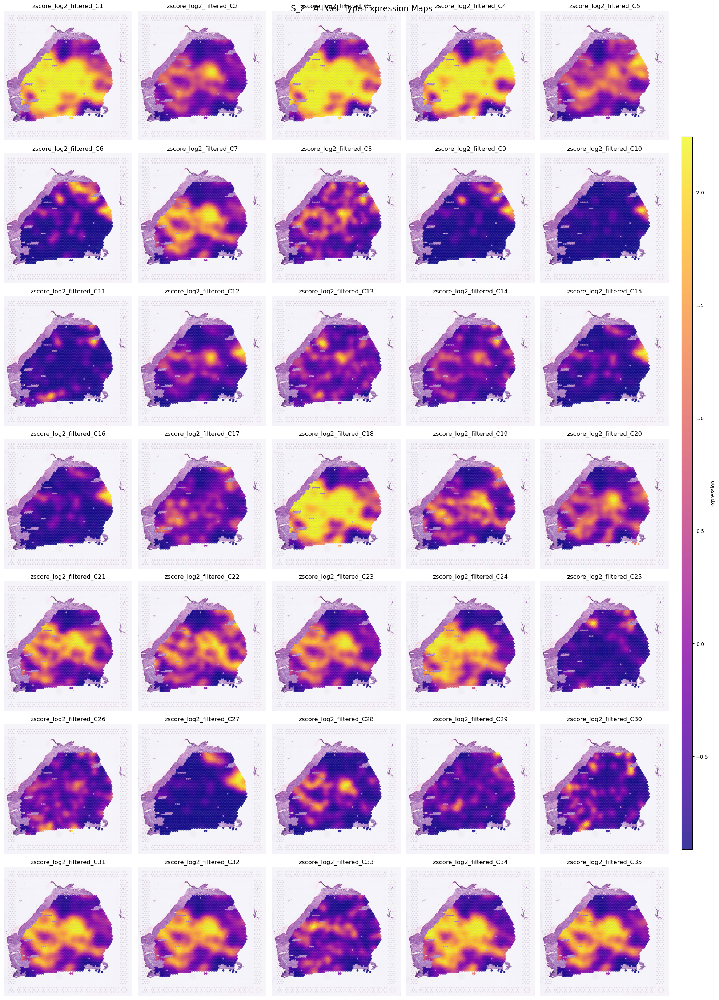

In [106]:
from python_scripts.expression_plot_utils import plot_all_celltypes_on_slide
plot_all_celltypes_on_slide(
    slide_id = "S_2",
    cell_prefix="zscore_log2_filtered_",
    image_path="./dataset/elucidata_ai_challenge_data.h5",
    spot_path="./dataset/gu_smooth_processed_train_spots.h5",
    group_name="log2_Train"
)

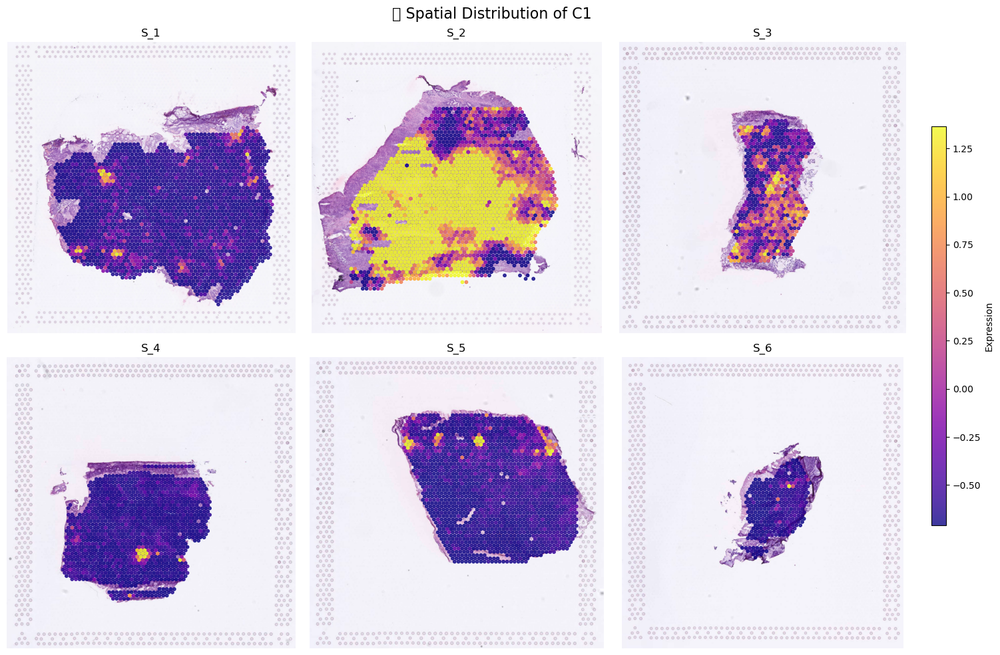

In [117]:
from python_scripts.expression_plot_utils import plot_cell_expression_all_slides
plot_cell_expression_all_slides(
    cell_short_name='C1',
    cell_prefix='zscore_log2_filtered_',
    image_path="./dataset/elucidata_ai_challenge_data.h5",
    spot_path="./dataset/processed_train_spots.h5",
    group_name="log2_Train"
)

In [107]:
from sklearn.neighbors import KDTree
import numpy as np
import pandas as pd
from python_scripts.spatial_smooth import gaussian_spatial_smoothing
from python_scripts.spatial_smooth import plot_cell_expression_comparison

cell_type_cols = [col for col in train_spot_tables["S_1"].columns if col.startswith("zscore_log2_filtered_C")]
smoothed_df = gaussian_spatial_smoothing(train_spot_tables["S_2"], cell_type_cols, radius=80)


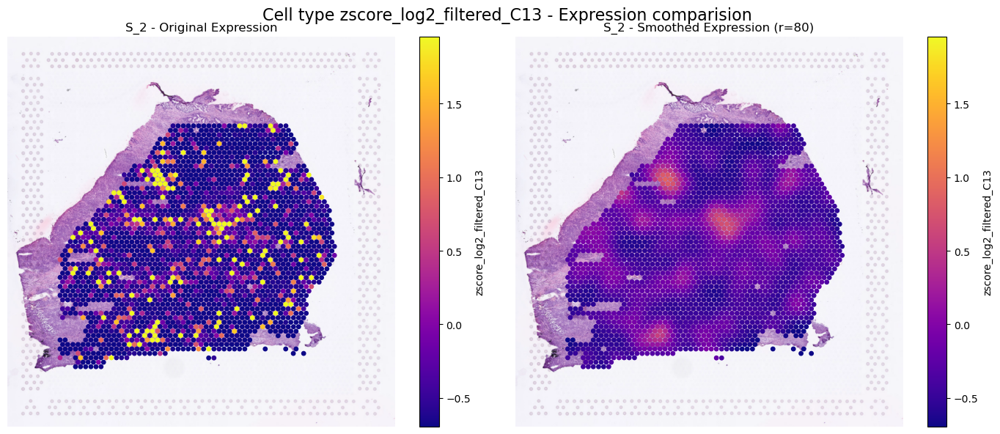

In [108]:
cell_type = "zscore_log2_filtered_C13"  # 可以換成任何你要看的 Cx
plot_cell_expression_comparison(
    slide_id="S_2",
    cell_type=cell_type,
    original_df=train_spot_tables["S_2"],
    smoothed_df=smoothed_df,
    radius = 80,
    h5_path="./dataset/elucidata_ai_challenge_data.h5"
)

In [109]:
import h5py
import numpy as np
from python_scripts.spatial_smooth import smooth_all_slides_and_save
# 先載入原本的資料（跟你之前一樣）
with h5py.File("./dataset/processed_train_spots.h5", "r") as f:
    train_spots = f["spots/log2_Train"]
    train_spot_tables = {
        slide: pd.DataFrame(np.array(train_spots[slide]))
        for slide in train_spots.keys()
    }

# 找出所有 cell type 欄位（z-score 後的）
cell_type_cols = [col for col in train_spot_tables["S_1"].columns if col.startswith("zscore_log2_filtered_C")]

# 設定儲存路徑
output_path = "./dataset/gu_smooth_processed_train_spots.h5"

# 執行平滑與儲存
smooth_all_slides_and_save(train_spot_tables, cell_type_cols, output_path, radius=80)


Processing slides: 100%|██████████| 6/6 [00:02<00:00,  2.20it/s]

✅ 所有 slide 都已平滑並存成 ./dataset/gu_smooth_processed_train_spots.h5，格式與 processed_train_spots.h5 相同！


## Tiles

In [2]:
def extract_tile(slide_img, x, y, tile_size=224):
    half = tile_size // 2
    x1, x2 = x - half, x + half
    y1, y2 = y - half, y + half
    tile = slide_img[y1:y2, x1:x2]  # shape: (224, 224, 3)
    return tile
def get_spots_in_tile(df, center_x, center_y, tile_size):
    half = tile_size // 2
    x_min, x_max = center_x - half, center_x + half
    y_min, y_max = center_y - half, center_y + half

    df_in_tile = df[
        (df['x'] >= x_min) & (df['x'] <= x_max) &
        (df['y'] >= y_min) & (df['y'] <= y_max)
    ].copy()

    df_in_tile = df_in_tile[
        ~((df_in_tile['x'] == center_x) & (df_in_tile['y'] == center_y))
    ]

    return df_in_tile


import matplotlib.pyplot as plt
import matplotlib.patches as patches

import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_tile_with_spots(
    slide_image, spot_df, center_x, center_y,
    tile_size=78, stride=None, grid_size=None,
    spot_radius_px=15
):
    """
    可視化一個 tile，包含中心 spot、鄰近 spot，以及可選的 N×N 子區格線。

    Parameters:
    - slide_image: 該張切片的影像 (numpy array, H x W x 3)
    - spot_df: 包含所有落在 tile 內的 spots（已排除中心點）
    - center_x, center_y: 中心 spot 的 slide 座標
    - tile_size: 單一 tile 的大小（像素）
    - stride: tile 間距（默認等於 tile_size，表示無重疊）
    - grid_size: 幾乘幾的 tile（如果 None，就只畫單 tile）
    - spot_radius_px: 中心 spot 畫圓半徑
    """

    if stride is None:
        stride = tile_size

    if grid_size:
        full_tile_size = tile_size + stride * (grid_size - 1)
    else:
        full_tile_size = tile_size

    center_color = 'red'
    neighbor_color = 'orange'
    show_legend = True
    title = f"{len(spot_df)} neighbors in tile"

    # 擷取 tile
    def extract_tile(slide_img, x, y, total_size):
        x, y = int(x), int(y)
        half = total_size // 2
        x1, x2 = x - half, x + half
        y1, y2 = y - half, y + half
        tile = slide_img[y1:y2, x1:x2]
        return tile

    tile = extract_tile(slide_image, center_x, center_y, full_tile_size)

    # 畫圖
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(tile)

    # 畫格線
    # 畫出每個 tile 的實際切割框
    if grid_size:
        for row in range(grid_size):
            for col in range(grid_size):
                x0 = col * stride
                y0 = row * stride
                rect = patches.Rectangle(
                    (x0, y0),
                    tile_size, tile_size,
                    linewidth=1,
                    edgecolor='blue',
                    facecolor='none',
                    linestyle='--'
                )
                ax.add_patch(rect)


    # 中心 spot（固定畫在 tile 中央）
    center_px = full_tile_size // 2
    ax.scatter(center_px, center_px, c=center_color, s=40, label='Center Spot')

    # 中心 spot 圓圈
    circle = patches.Circle(
        (center_px, center_px),
        spot_radius_px,
        linewidth=1.5,
        edgecolor='yellow',
        facecolor='none'
    )
    ax.add_patch(circle)

    # 鄰居 spots（轉成 tile 內相對座標）
    for _, neighbor in spot_df.iterrows():
        dx = int(neighbor['x']) - center_x
        dy = int(neighbor['y']) - center_y
        tile_x = center_px + dx
        tile_y = center_px + dy
        ax.scatter(tile_x, tile_y, c=neighbor_color, s=20)

    ax.axis('off')
    if show_legend:
        ax.legend(loc='upper right')
    ax.set_title(title)
    plt.tight_layout()
    plt.show()


## calculate tile_size

In [232]:
from scipy.spatial.distance import pdist, squareform
import numpy as np

train_spacing_per_slide = {}

for slide_id, df in train_spot_tables.items():
    coords = df[['x', 'y']].values
    if len(coords) < 2:
        print(f"⚠️ Slide {slide_id} has less than 2 spots, skipping.")
        continue

    dist_matrix = squareform(pdist(coords))
    np.fill_diagonal(dist_matrix, np.inf)
    min_dists = dist_matrix.min(axis=1)
    mean_spacing = min_dists.mean()

    train_spacing_per_slide[slide_id] = mean_spacing
    print(f"📏 {slide_id}: 平均 spot 間距 = {mean_spacing:.2f} pixels")




📏 S_1: 平均 spot 間距 = 25.90 pixels
📏 S_2: 平均 spot 間距 = 25.95 pixels
📏 S_3: 平均 spot 間距 = 25.20 pixels
📏 S_4: 平均 spot 間距 = 25.02 pixels
📏 S_5: 平均 spot 間距 = 25.01 pixels
📏 S_6: 平均 spot 間距 = 25.24 pixels


## show image

In [235]:
df

,x,y,zscore_boxcox_filtered_C1,zscore_boxcox_filtered_C2,zscore_boxcox_filtered_C3,zscore_boxcox_filtered_C4,zscore_boxcox_filtered_C5,zscore_boxcox_filtered_C6,zscore_boxcox_filtered_C7,zscore_boxcox_filtered_C8,...,zscore_boxcox_filtered_C26,zscore_boxcox_filtered_C27,zscore_boxcox_filtered_C28,zscore_boxcox_filtered_C29,zscore_boxcox_filtered_C30,zscore_boxcox_filtered_C31,zscore_boxcox_filtered_C32,zscore_boxcox_filtered_C33,zscore_boxcox_filtered_C34,zscore_boxcox_filtered_C35
0,1554,1297,-0.807554,-0.360270,-0.770386,-0.672475,0.265916,2.001631,-0.532350,1.691380,...,-0.605304,2.045493,2.112412,-0.350800,-0.624196,-0.508417,-0.397906,2.095183,-0.672645,0.305556
1,462,1502,-0.377804,1.058089,-0.305202,-0.349273,1.743446,-0.528213,1.273565,-0.424314,...,-0.636450,-0.472438,-0.693401,0.346762,-0.623137,1.305537,0.651690,-0.372276,-0.466728,0.293449
2,1488,1548,-0.316145,-0.736962,-0.548125,-0.660728,0.860024,-0.484759,-0.793829,-0.725340,...,-0.695534,0.737149,-0.565525,-0.683067,-0.625741,-0.759908,-0.807187,-0.361456,-0.758553,-0.642828
3,1725,1182,-0.486695,1.262300,-0.400584,-0.570226,1.843784,1.058490,1.810053,0.803700,...,-0.513186,0.693139,-0.497946,1.056063,-0.623349,1.108347,1.428330,-0.396488,-0.642688,1.242892
4,581,1113,-0.333254,-0.222017,-0.359309,-0.317615,1.571128,-0.643542,-0.107410,-0.656473,...,-0.697919,-0.585794,-0.714744,-0.397894,-0.518633,-0.224850,-0.481956,-0.685243,-0.785179,-0.721330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2144,1055,701,-0.656018,0.369161,-0.595855,-0.669139,-1.060752,1.884390,0.418805,1.148998,...,-0.016903,1.784396,2.112412,2.081323,-0.624897,-0.252265,0.788961,-0.439651,-0.404115,1.344582
2145,1225,862,-0.555407,0.438458,0.033861,-0.676472,-1.048821,2.001631,0.222995,-0.023849,...,1.528311,1.863013,2.112412,2.081323,-0.625685,-0.261187,0.855438,0.949169,0.303528,1.885057
2146,765,1479,-0.115359,-0.517121,-0.134602,-0.661545,-0.637573,-0.659606,-0.971976,-0.732354,...,-0.678885,-0.664267,-0.717682,-0.718653,-0.619550,-0.657390,-0.776997,-0.690987,-0.784096,-0.956297
2147,607,1525,-0.863621,0.738064,-0.807433,-0.686567,1.017651,-0.660826,-0.378222,-0.505425,...,-0.569547,-0.615574,-0.563459,1.838163,-0.527867,0.092713,0.794469,-0.018085,-0.786584,-0.310585


In [252]:
# 隨機抽一筆資料（從全體 tiles 中）
with h5py.File("./dataset/filtered&masked_dataset.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    
    sample = 'S_1'
    image = np.array(train_images[sample])


🔍 所有 slide tile size 78 pixels
Found 70 spots in this tile.


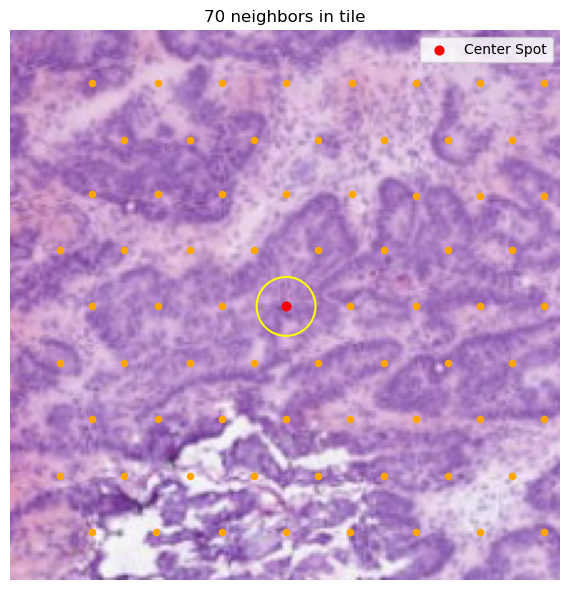

In [258]:
import random

tile_size = round(max(train_spacing_per_slide.values())*3)  # → round(77.7) → 78
print(f"\n🔍 所有 slide tile size {tile_size} pixels")

df = train_spot_tables['S_1']
i = random.randint(0, len(df) - 1)

row = df.iloc[i]

x = 423
y = 975

# 取得tile範圍內的spot們
neighbors_df = get_spots_in_tile(df, x, y, tile_size=224)

print(f"Found {len(neighbors_df)} spots in this tile.")
#print(neighbors_df[['x', 'y']])
##print(x,y)
plot_tile_with_spots(
    slide_image=image,
    spot_df=neighbors_df,
    center_x=x,
    center_y=y,
    tile_size=224,
    #grid_size=3,
    spot_radius_px=12
)


NameError: name 'train_M_tile_norm_tiles' is not defined

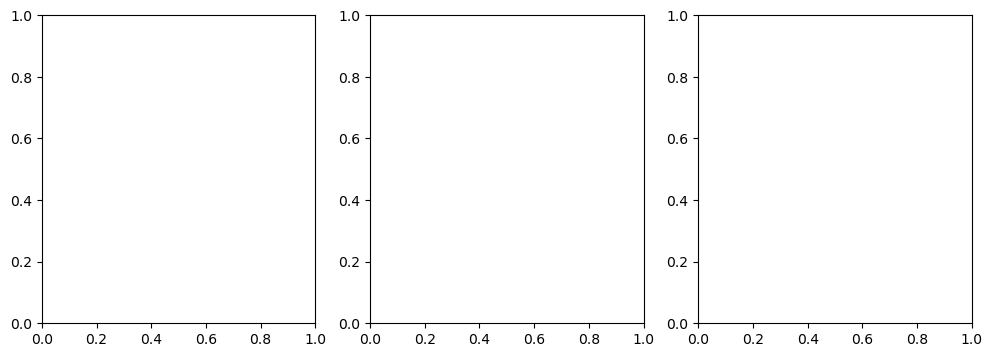

In [20]:

fig, axes = plt.subplots(1, 3, figsize=(12, 4))
channel_names = ['R', 'G', 'B']
for i, ax in enumerate(axes):
    ax.imshow(train_M_tile_norm_tiles[8000][:,:,i], cmap='gray')
    ax.set_title(channel_names[i])
    ax.axis('off')
plt.tight_layout()
plt.show()
plt.imshow(train_M_tile_norm_tiles[8000])


## Start tiling

### Ad binary to 4 dimenosion

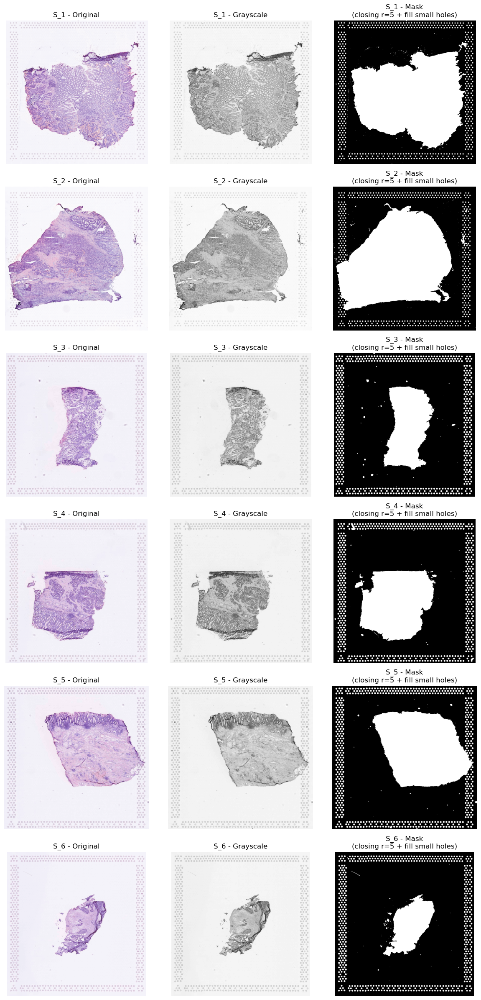

In [8]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import threshold_mean
from skimage.morphology import closing, remove_small_holes, disk

# 你的自定义阈值
custom_thresholds = {
    "S_1": 0.90,
    "S_2": 0.91,
    "S_3": 0.91,
    "S_4": 0.90,
    "S_5": 0.91,
    "S_6": 0.91,
}

with h5py.File("./dataset/hed_normalize_image.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_images.keys())

    n = len(slide_ids)
    fig, axs = plt.subplots(nrows=n, ncols=3, figsize=(12, 4 * n))
    if n == 1:
        axs = [axs]

    for i, slide_id in enumerate(slide_ids):
        image = np.array(train_images[slide_id])
        gray = rgb2gray(image)

        # 1) 二值化
        thresh = custom_thresholds.get(slide_id, threshold_mean(gray))
        mask = gray <= thresh  # True = tissue

        # 2) 闭运算：用一个小圆盘核把洞“填平”——调整 radius 试试效果
        mask_closed = closing(mask, disk(2))

        # 3) 再去除/填充小洞：area_threshold 小于这个大小的洞都会被填满
        mask_filled = remove_small_holes(
            mask_closed,
            area_threshold=5000,  # 根据洞的大小调这个参数
            connectivity=2
        )

        axs[i][0].imshow(image)
        axs[i][0].set_title(f"{slide_id} - Original")
        axs[i][0].axis("off")

        axs[i][1].imshow(gray, cmap="gray")
        axs[i][1].set_title(f"{slide_id} - Grayscale")
        axs[i][1].axis("off")

        axs[i][2].imshow(mask_filled, cmap="gray")
        axs[i][2].set_title(
            f"{slide_id} - Mask\n(closing r=5 + fill small holes)"
        )
        axs[i][2].axis("off")

    plt.tight_layout()
    plt.show()



/var/folders/7g/j5s0yzcj34l3v043s7znkplc0000gn/T/ipykernel_88076/1417528706.py:74: UserWarning: Glyph 21407 (\N{CJK UNIFIED IDEOGRAPH-539F}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/7g/j5s0yzcj34l3v043s7znkplc0000gn/T/ipykernel_88076/1417528706.py:74: UserWarning: Glyph 22270 (\N{CJK UNIFIED IDEOGRAPH-56FE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/7g/j5s0yzcj34l3v043s7znkplc0000gn/T/ipykernel_88076/1417528706.py:74: UserWarning: Glyph 32452 (\N{CJK UNIFIED IDEOGRAPH-7EC4}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/7g/j5s0yzcj34l3v043s7znkplc0000gn/T/ipykernel_88076/1417528706.py:74: UserWarning: Glyph 32455 (\N{CJK UNIFIED IDEOGRAPH-7EC7}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/7g/j5s0yzcj34l3v043s7znkplc0000gn/T/ipykernel_88076/1417528706.py:74: UserWarning: Glyph 21333 (\N{CJK UNIFIED IDEOGRAPH-5355}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/7g/j5s0

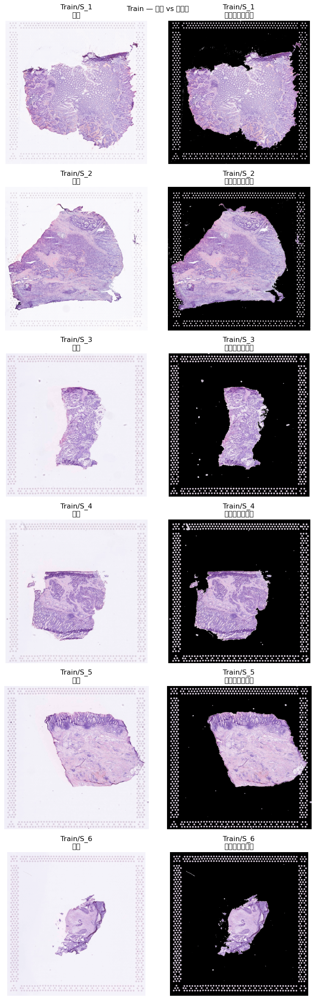

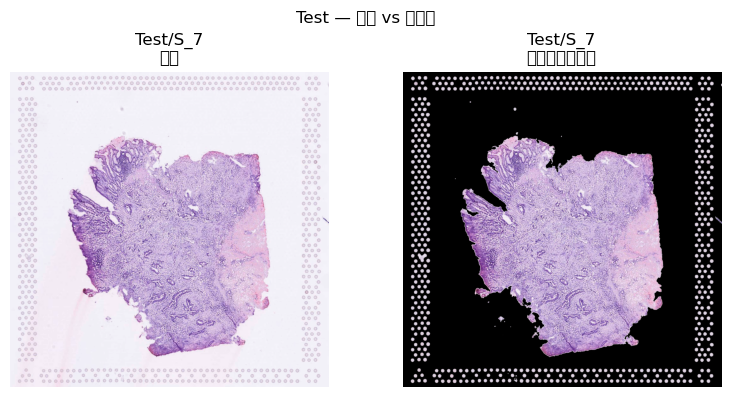

✅ 处理完毕，保存至 ./dataset/hed_normalize_image_masked.h5


In [13]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import threshold_mean
from skimage.morphology import closing, remove_small_holes, disk
import os

# 自定义灰度阈值
custom_thresholds = {
    "S_1": 0.90,
    "S_2": 0.91,
    "S_3": 0.90,
    "S_4": 0.90,
    "S_5": 0.89,
    "S_6": 0.91,
    "S_7": 0.87,  # 假如 Test 也有 S_7
}

# 输入／输出文件
in_path  = "./dataset/hed_normalize_image.h5"
out_path = "./dataset/hed_normalize_image_masked.h5"
os.makedirs(os.path.dirname(out_path), exist_ok=True)

with h5py.File(in_path,  "r") as h5in, \
     h5py.File(out_path, "w") as h5out:

    for split in ["Train", "Test"]:
        grp_in  = h5in[f"images/{split}"]
        grp_out = h5out.create_group(f"images/{split}")

        slide_ids = list(grp_in.keys())
        n = len(slide_ids)
        fig, axs = plt.subplots(n, 2, figsize=(8, 4*n))
        if n==1: axs = np.expand_dims(axs,0)

        for i, sid in enumerate(slide_ids):
            img = np.array(grp_in[sid])  # float32 [0,1]
            gray = rgb2gray(img)

            # 1) 二值化
            thresh = custom_thresholds.get(sid, threshold_mean(gray))
            mask = gray <= thresh       # True=组织

            # 2) 闭运算填洞
            mask_closed = closing(mask, disk(2))
            # 3) 填充剩余小孔
            mask_filled = remove_small_holes(
                mask_closed,
                area_threshold=5000,
                connectivity=2
            )

            # 4) 用 mask_filled 把背景置零 (或 1，看需求)
            masked = img.copy()
            masked[~mask_filled] = 0.0

            # 5) 存储到新 h5
            grp_out.create_dataset(
                sid,
                data=masked
            )

            # 6) 绘图对比
            ax1, ax2 = axs[i]
            ax1.imshow(img)
            ax1.set_title(f"{split}/{sid}\n原图")
            ax1.axis("off")
            ax2.imshow(masked)
            ax2.set_title(f"{split}/{sid}\n组织单元掩码后")
            ax2.axis("off")

        plt.suptitle(f"{split} — 原图 vs 掩码后")
        plt.tight_layout()
        plt.show()

print("✅ 处理完毕，保存至", out_path)


In [6]:
import h5py
import numpy as np

# slide_masks 假設已經存在，是一個 dict：slide_id -> binary mask (np.array)
new_slide_masks = {}
with h5py.File("./dataset/filtered&masked_dataset.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_images.keys())

    for slide_id in slide_ids:
        image = np.array(train_images[slide_id])  # shape: (H, W, 3)
        mask = slide_masks[slide_id].copy()  # ✅ 獨立副本

        # 👉 建立一個 image-level mask，判斷哪些 pixel 全部通道為 0
        image_zero_mask = np.all(image == 0, axis=-1)  # shape: (H, W), bool

        # ✅ 將 slide_mask 中那些對應 0 的地方也設為 0
        mask[image_zero_mask] = 0
        new_slide_masks[slide_id] = mask  # 更新回去（其實不用這行，原本就是 mutable）

        print(f"✔️ {slide_id} 已同步處理，0 區塊從 image -> mask 傳遞完成。")


✔️ S_1 已同步處理，0 區塊從 image -> mask 傳遞完成。
✔️ S_2 已同步處理，0 區塊從 image -> mask 傳遞完成。
✔️ S_3 已同步處理，0 區塊從 image -> mask 傳遞完成。
✔️ S_4 已同步處理，0 區塊從 image -> mask 傳遞完成。
✔️ S_5 已同步處理，0 區塊從 image -> mask 傳遞完成。
✔️ S_6 已同步處理，0 區塊從 image -> mask 傳遞完成。


Text(0.5, 1.0, 'Mask After Aligning with Image Zero')

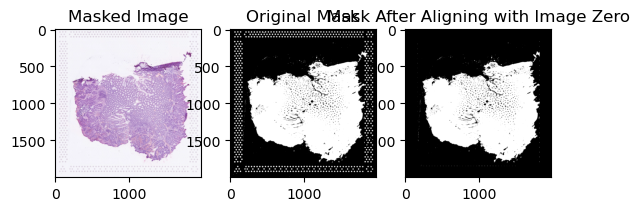

In [359]:
slide_id = 'S_1'
plt.subplot(1, 3, 1)
plt.imshow(slide[slide_id])
plt.title("Masked Image")

plt.subplot(1, 3, 2)
plt.imshow(slide_masks[slide_id] , cmap="gray")
plt.title("Original Mask")

plt.subplot(1, 3, 3)
plt.imshow(new_slide_masks[slide_id], cmap="gray")
plt.title("Mask After Aligning with Image Zero")


In [7]:
combined_slide_images = {}  # slide_id -> (H, W, 4)

for slide_id in slide.keys():
    image = slide[slide_id]                  # shape: (H, W, 3)
    mask = new_slide_masks[slide_id]         # shape: (H, W)

    # ✅ 先把 mask 加一個通道軸，變成 (H, W, 1)
    mask = np.expand_dims(mask, axis=-1)

    # ✅ 合併成 (H, W, 4)
    combined = np.concatenate([image, mask], axis=-1)  # 如果想讓 mask 是 0/255 表示可視化

    combined_slide_images[slide_id] = combined
    print(f"✔️ 合併完成: {slide_id} → shape {combined.shape}")


✔️ 合併完成: S_1 → shape (2000, 1974, 4)
✔️ 合併完成: S_2 → shape (2000, 1988, 4)
✔️ 合併完成: S_3 → shape (2000, 1966, 4)
✔️ 合併完成: S_4 → shape (2000, 1979, 4)
✔️ 合併完成: S_5 → shape (1985, 2000, 4)
✔️ 合併完成: S_6 → shape (2000, 1930, 4)


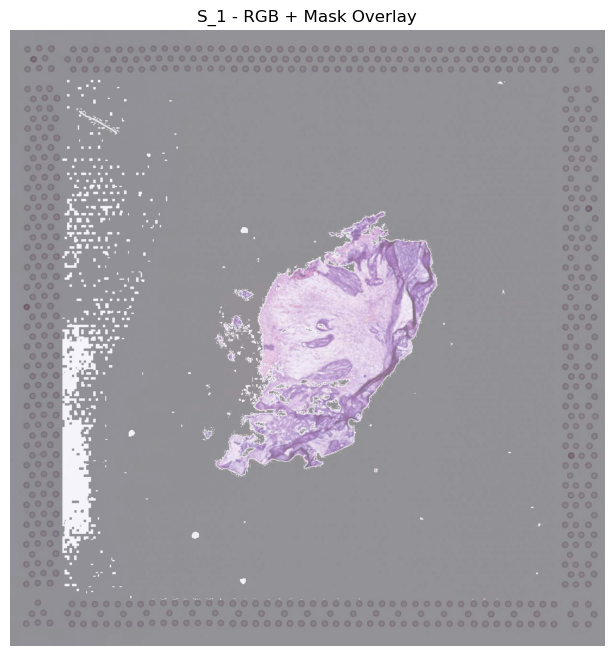

In [ ]:
plt.figure(figsize=(8, 8))
plt.imshow(combined_slide_images['S_6'][:, :, :3])  # RGB
plt.imshow(combined_slide_images['S_6'][:, :, 3], cmap='gray', alpha=0.4)  # Mask 疊加
plt.title("S_1 - RGB + Mask Overlay")
plt.axis('off')
plt.show()


In [363]:
import h5py
import numpy as np

output_path = "./dataset/combined_slide_images_with_mask.h5"

with h5py.File(output_path, "w") as f:
    image_group = f.create_group("images/Train")

    for slide_id, combined_img in combined_slide_images.items():
        image_group.create_dataset(slide_id, data=combined_img)
        print(f"✔️ 已儲存 {slide_id} → shape {combined_img.shape}")

print(f"\n✅ 所有圖像+mask 已儲存到：{output_path}")


✔️ 已儲存 S_1 → shape (2000, 1974, 4)
✔️ 已儲存 S_2 → shape (2000, 1988, 4)
✔️ 已儲存 S_3 → shape (2000, 1966, 4)
✔️ 已儲存 S_4 → shape (2000, 1979, 4)
✔️ 已儲存 S_5 → shape (1985, 2000, 4)
✔️ 已儲存 S_6 → shape (2000, 1930, 4)

✅ 所有圖像+mask 已儲存到：./dataset/combined_slide_images_with_mask.h5


### Normal channel

In [263]:
import numpy as np

def normalize_patch_zscore(patch):
    """
    對 RGB 圖片做 per-channel Z-score normalization
    patch: shape (H, W, 3), dtype=float32 or uint8
    return: same shape, normalized float32 patch
    """
    patch = patch.astype(np.float32)

    # 計算每個通道的 mean/std
    means = patch.mean(axis=(0, 1), keepdims=True)
    stds = patch.std(axis=(0, 1), keepdims=True) + 1e-12  # 避免除以 0

    return (patch - means) / stds


In [ ]:
import h5py
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import torch

train_S_tiles = []
train_M_tiles = []
train_L_tiles = []
train_labels = []
normal_coords = []
coords= []
train_S_tile_norm_tiles = []
train_M_tile_norm_tiles = []
train_L_tile_norm_tiles = []

with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_spot_tables.keys())

    for slide_id in slide_ids:
        if slide_id not in train_images:
            print(f"⚠️ Slide {slide_id} not found in HDF5, skipping.")
            continue

        image = train_images[slide_id][()]  # H x W x 3
        df = train_spot_tables[slide_id]

        
        # 提取 (x, y) 座標並進行標準化
        ext_coords = df[['x', 'y']].values
        scaler = MinMaxScaler()
        coords_normalized = scaler.fit_transform(ext_coords)  # 將座標標準化到 [0, 1] 範圍內
                # 儲存標準化後的 (x, y) 座標
        df[['x_normalized', 'y_normalized']] = coords_normalized
        
        for i, row in df.iterrows():
            x, y = int(row['x']), int(row['y'])

            train_S_tile = extract_tile(image, x, y, tile_size=32)
            train_S_tile_norm = normalize_patch_zscore(train_S_tile)

            train_M_tile = extract_tile(image, x, y, tile_size=112)
            train_M_tile_norm = normalize_patch_zscore(train_M_tile)

            train_L_tile = extract_tile(image, x, y, tile_size=224)
            train_L_tile_norm = normalize_patch_zscore(train_L_tile)


            label = row.iloc[2:-2].values.astype(np.float32)

            train_S_tiles.append(train_S_tile)
            train_M_tiles.append(train_M_tile)
            train_L_tiles.append(train_L_tile)  # ✅ 存入
            train_S_tile_norm_tiles.append(train_S_tile_norm)
            train_M_tile_norm_tiles.append(train_M_tile_norm)
            train_L_tile_norm_tiles.append(train_L_tile_norm)  # ✅ 存入
            train_labels.append(label)
            normal_coords.append((row['x_normalized'], row['y_normalized']))
            coords.append((int(row['x']), int(row['y'])))
            

NameError: name 'normalize_patch_zscore' is not defined

### confidence calculation

In [ ]:
from scipy.spatial import KDTree

def compute_neighbor_based_confidence(coords, radius=0.05, min_conf=0.5, max_conf=1.0):
    """
    根據每個點附近 neighbor 的數量來估計 confidence（密集的點給高 confidence）
    :param coords: np.array of shape (N, 2)，normalized 座標
    :param radius: 半徑範圍內計算鄰居數（建議 0.03~0.08）
    :return: List of confidence 分數
    """
    tree = KDTree(coords)
    neighbor_counts = tree.query_ball_point(coords, r=radius)
    num_neighbors = np.array([len(nlist) for nlist in neighbor_counts])

    # 正規化 neighbor 數量
    max_neighbors = np.max(num_neighbors)
    norm_neighbors = num_neighbors / max_neighbors

    # confidence = 鄰居越多越可靠（線性轉換）
    confidences = min_conf + norm_neighbors * (max_conf - min_conf)
    return confidences


In [ ]:
import h5py
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from scipy.spatial import KDTree
import torch

# ======= 預先定義的工具 =======

def compute_neighbor_based_confidence(coords, radius=0.05, min_conf=0.5, max_conf=1.0):
    tree = KDTree(coords)
    neighbor_counts = tree.query_ball_point(coords, r=radius)
    num_neighbors = np.array([len(nlist) for nlist in neighbor_counts])
    max_neighbors = np.max(num_neighbors)
    norm_neighbors = num_neighbors / max_neighbors
    confidences = min_conf + norm_neighbors * (max_conf - min_conf)
    return confidences

def combine_confidences(global_conf, local_conf, w_global=0.5, w_local=0.5):
    return w_global * np.array(global_conf) + w_local * np.array(local_conf)

# ======= 資料儲存區 =======

train_S_tiles = []
train_M_tiles = []
train_L_tiles = []
train_labels = []
normal_coords = []
coords = []
confidences = []  # ✅ confidence list
confidence_slide_ids = []

# ======= 主迴圈 =======

with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_spot_tables.keys())

    for slide_id in slide_ids:
        if slide_id not in train_images:
            print(f"⚠️ Slide {slide_id} not found in HDF5, skipping.")
            continue

        image = train_images[slide_id][()]  # H x W x 3
        df = train_spot_tables[slide_id]

        # Step 1: 原始 (x, y)
        ext_coords = df[['x', 'y']].values

        # Step 2: 計算 pixel 範圍
        x_range = df['x'].max() - df['x'].min()
        y_range = df['y'].max() - df['y'].min()

        # Step 3: pixel radius 轉換為 normalized radius
        radius_pixel = 112
        radius_x_norm = radius_pixel / x_range
        radius_y_norm = radius_pixel / y_range
        normalized_radius = max(radius_x_norm, radius_y_norm)

        # Step 4: 標準化座標
        scaler = MinMaxScaler()
        coords_normalized = scaler.fit_transform(ext_coords)
        df[['x_normalized', 'y_normalized']] = coords_normalized


        # ✅ 計算 Global 中心距離 confidence
        cx, cy = coords_normalized[:, 0].mean(), coords_normalized[:, 1].mean()
        dists = np.linalg.norm(coords_normalized - np.array([cx, cy]), axis=1)
        max_dist = np.max(dists)
        global_conf = 1.0 - (dists / max_dist) * 0.5
        global_conf = np.clip(global_conf, 0.5, 1.0)

        # ✅ 計算 Local neighbor-based confidence
        
        local_conf = compute_neighbor_based_confidence(coords_normalized, radius=normalized_radius)

        # ✅ 融合 confidence
        slide_confidences = combine_confidences(global_conf, local_conf, w_global=0, w_local=1)

        for i, row in df.iterrows():
            x, y = int(row['x']), int(row['y'])
            nx, ny = row['x_normalized'], row['y_normalized']
            confidence = slide_confidences[i]

            # 擷取 tile
            train_S_tile = extract_tile(image, x, y, tile_size=32)
            train_M_tile = extract_tile(image, x, y, tile_size=112)
            train_L_tile = extract_tile(image, x, y, tile_size=224)
            label = row.iloc[2:-2].values.astype(np.float32)

            # 儲存
            train_S_tiles.append(train_S_tile)
            train_M_tiles.append(train_M_tile)
            train_L_tiles.append(train_L_tile)
            train_labels.append(label)
            coords.append((x, y))
            normal_coords.append((nx, ny))
            confidences.append(confidence)
            confidence_slide_ids.append(slide_id)


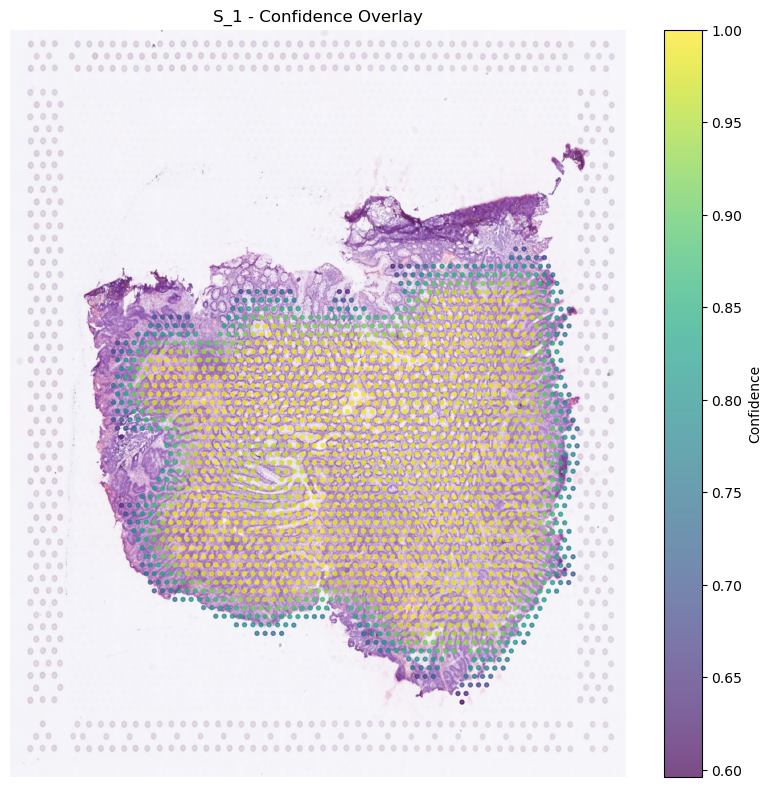

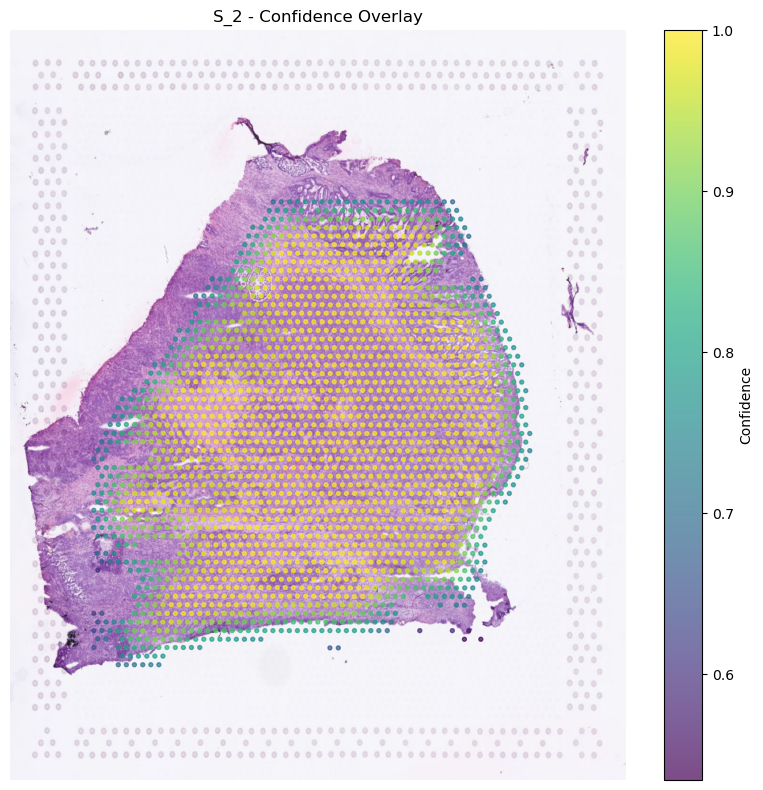

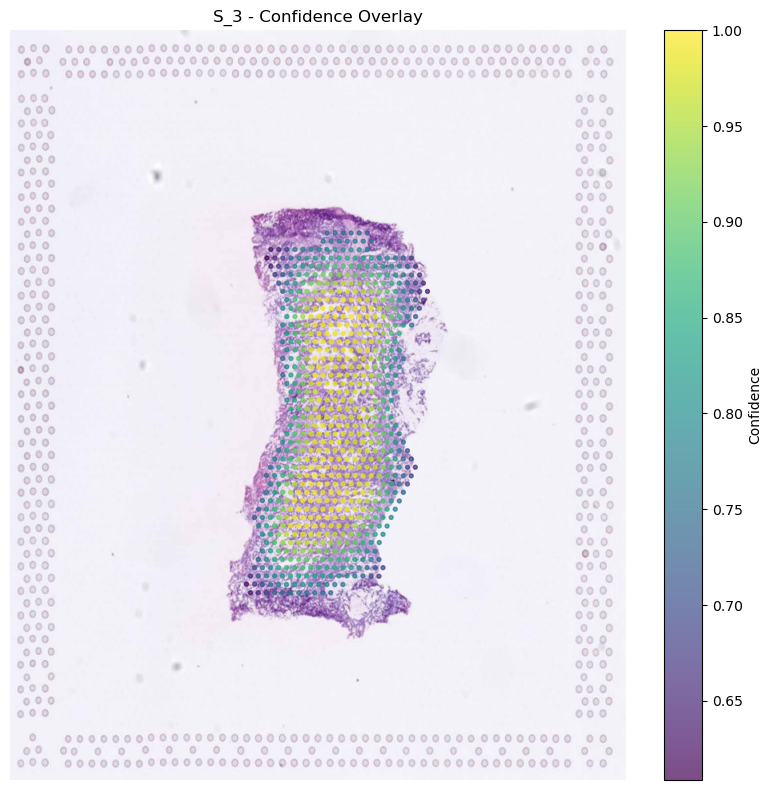

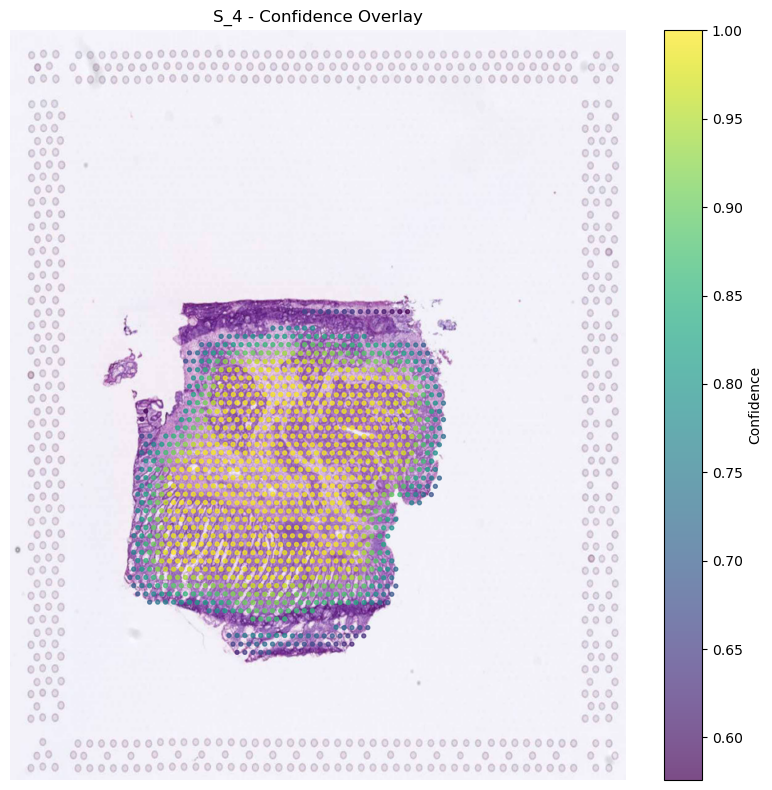

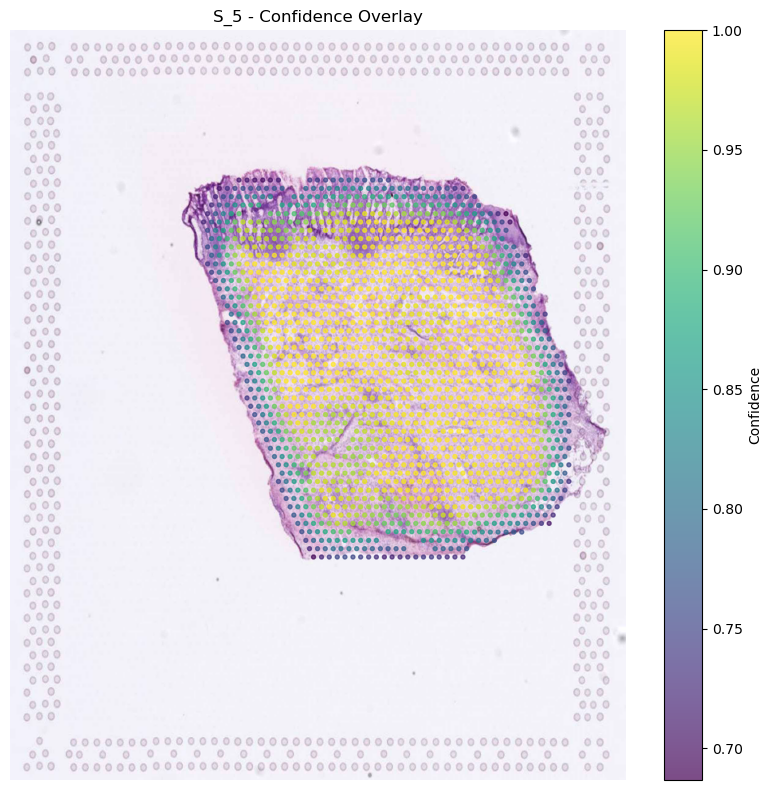

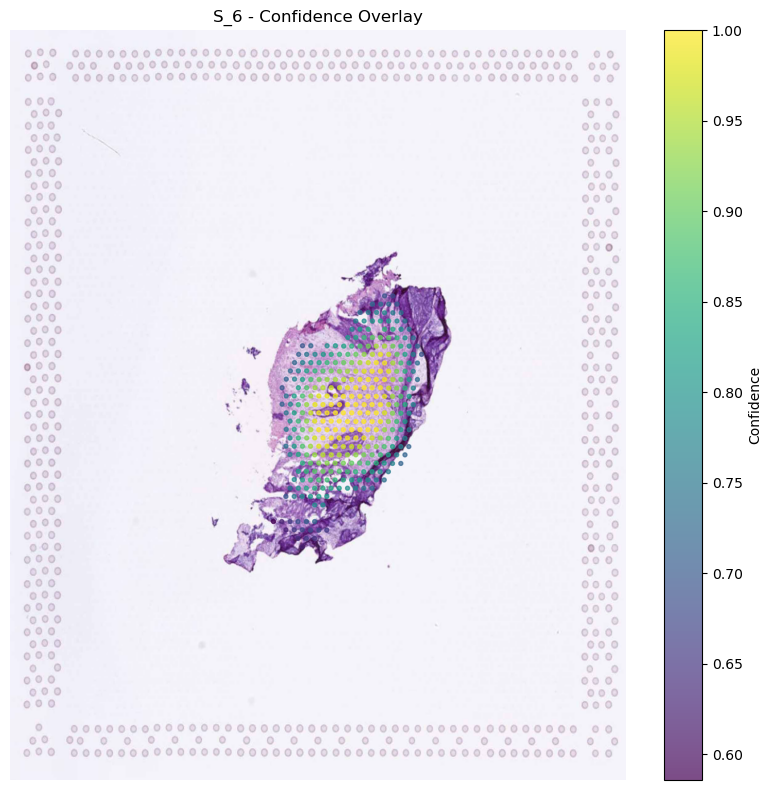

In [ ]:
import matplotlib.pyplot as plt
import h5py
import numpy as np

# 👉 如果你還沒開啟 h5file 的 context，先開一次
with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    
    unique_slides = sorted(set(confidence_slide_ids))

    for slide_id in unique_slides:
        # 取出該 slide 的背景圖
        image = np.array(train_images[slide_id])

        # 取出該 slide 的所有 spot 和 confidence
        slide_xy = [xy for xy, sid in zip(coords, confidence_slide_ids) if sid == slide_id]
        slide_conf = [c for c, sid in zip(confidences, confidence_slide_ids) if sid == slide_id]

        x_vals = [x for x, y in slide_xy]
        y_vals = [y for x, y in slide_xy]

        # 畫圖
        plt.figure(figsize=(8, 8))
        plt.imshow(image, aspect="auto")
        sc = plt.scatter(x_vals, y_vals, c=slide_conf, cmap='viridis', s=8, alpha=0.7)
        plt.colorbar(sc, label='Confidence')
        plt.title(f"{slide_id} - Confidence Overlay")
        plt.axis('off')
        plt.tight_layout()
        plt.show()


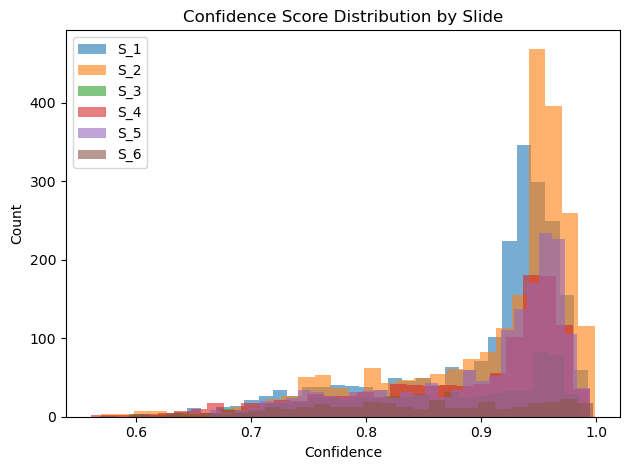

In [ ]:
for slide_id in slide_ids:
    slide_confs = [c for (c, sid) in zip(confidences, confidence_slide_ids) if sid == slide_id]
    plt.hist(slide_confs, bins=30, alpha=0.6, label=slide_id)

plt.title("Confidence Score Distribution by Slide")
plt.xlabel("Confidence")
plt.ylabel("Count")
plt.legend()
plt.tight_layout()
plt.show()


### Just cut

In [112]:
from sklearn.preprocessing import MinMaxScaler
with h5py.File("./dataset/gu_smooth_processed_train_spots.h5", "r") as f:
    train_spots = f["spots/log2_Train"]
    
    # Dictionary to store DataFrames for each slide
    train_spot_tables = {}
    
    for slide_name in train_spots.keys():
        # Load dataset as NumPy structured array
        spot_array = np.array(train_spots[slide_name])
        
        # Convert to DataFrame
        df = pd.DataFrame(spot_array)
        
        # Store in dictionary
        train_spot_tables[slide_name] = df
# ======= 資料儲存區 =======

train_S_tiles = []
train_M_tiles = []
train_L_tiles = []
train_labels = []
normal_coords = []
coords = []

# ======= 主迴圈 =======
#with h5py.File("./dataset/filtered&masked_dataset.h5", "r") as h5file:

with h5py.File("./dataset/combined_slide_images_with_mask.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_spot_tables.keys())

    for slide_id in slide_ids:
        if slide_id not in train_images:
            print(f"⚠️ Slide {slide_id} not found in HDF5, skipping.")
            continue

        image = train_images[slide_id][()]  # H x W x 3
        df = train_spot_tables[slide_id]

        # Step 4: 標準化座標
        ext_coords = df[['x', 'y']].values
        scaler = MinMaxScaler()
        coords_normalized = scaler.fit_transform(ext_coords)
        df[['x_normalized', 'y_normalized']] = coords_normalized

        for i, row in df.iterrows():
            x, y = int(row['x']), int(row['y'])
            nx, ny = row['x_normalized'], row['y_normalized']

            # 擷取 tile
            train_S_tile = extract_tile(image, x, y, tile_size=32)
            train_M_tile = extract_tile(image, x, y, tile_size=112)
            train_L_tile = extract_tile(image, x, y, tile_size=224)
            label = row.iloc[2:-2].values.astype(np.float32)

            # 儲存
            train_S_tiles.append(train_S_tile)
            train_M_tiles.append(train_M_tile)
            train_L_tiles.append(train_L_tile)
            train_labels.append(label)
            coords.append((x, y))
            normal_coords.append((nx, ny))

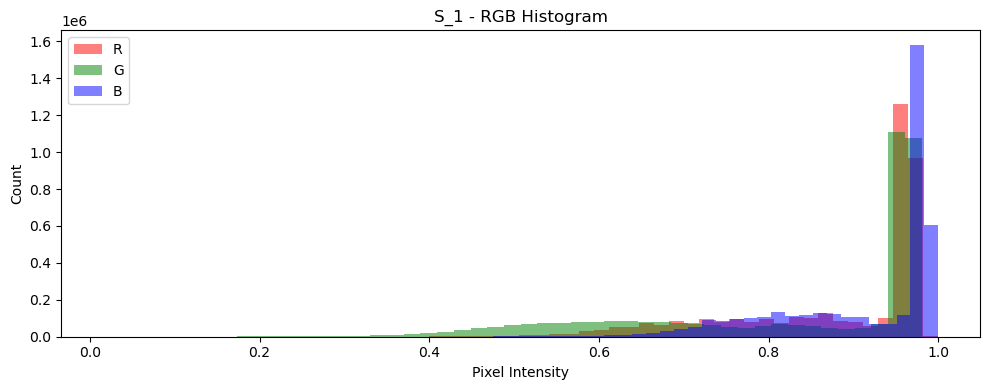

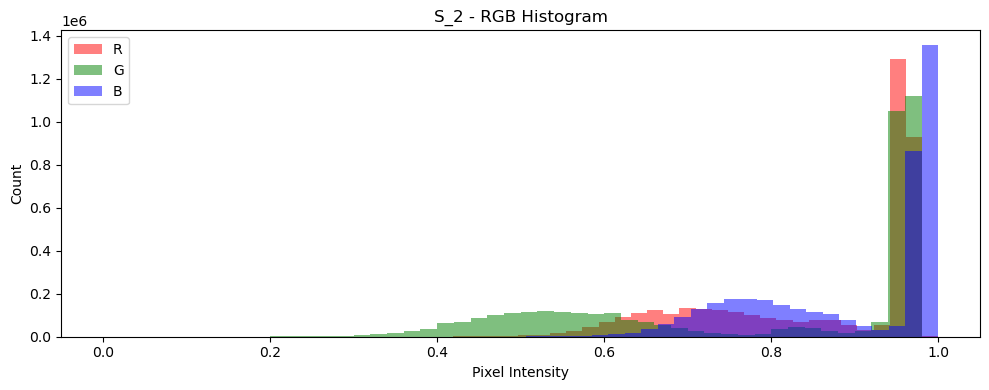

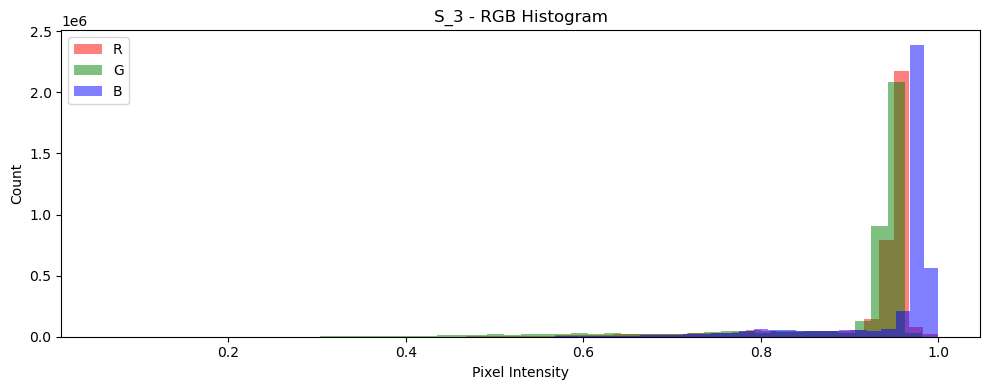

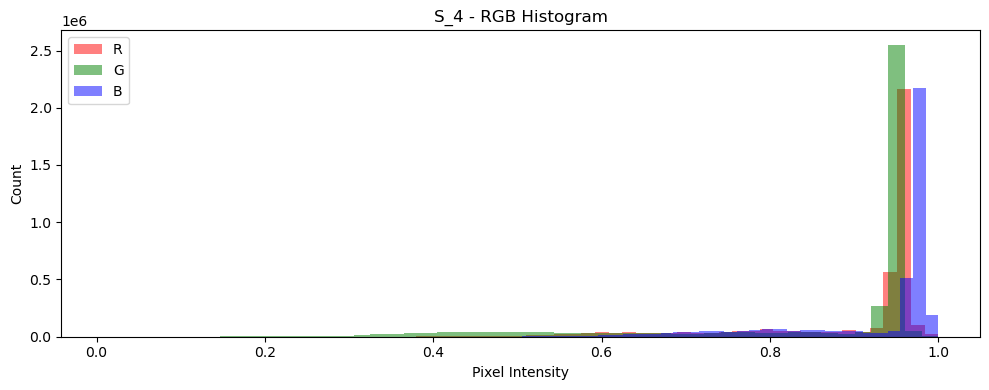

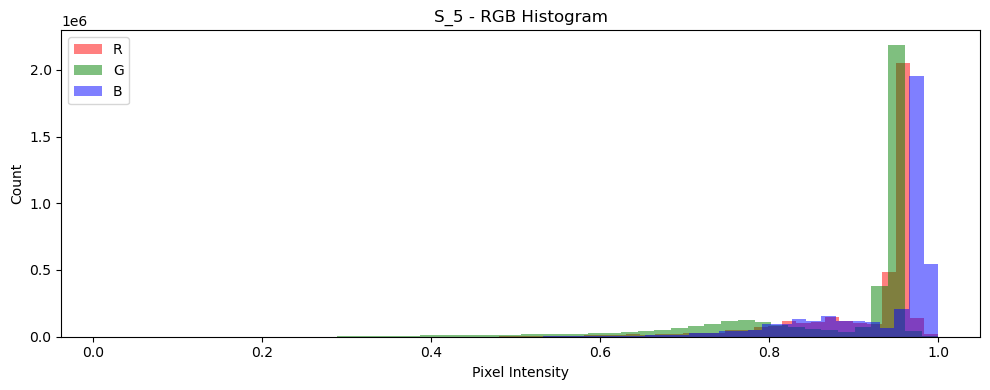

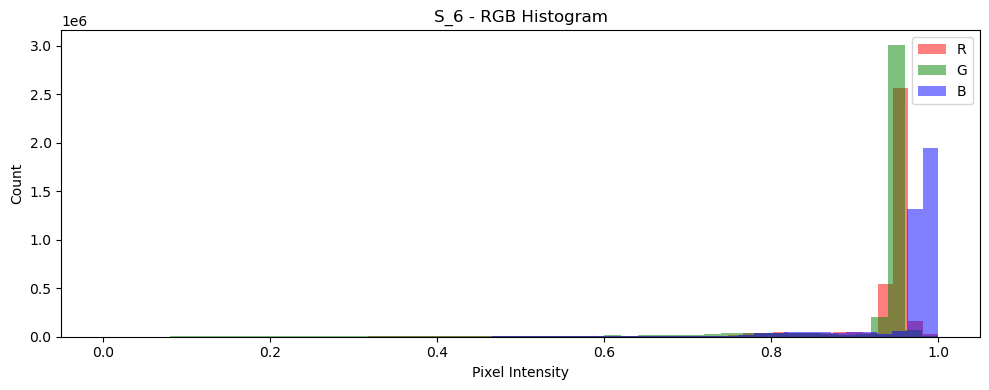

In [16]:
import h5py
import numpy as np
import matplotlib.pyplot as plt

with h5py.File("./dataset/combined_slide_images_with_mask.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_images.keys())  # 從 HDF5 拿 slide ids

    for slide_id in slide_ids:
        image = np.array(train_images[slide_id])  # shape: (H, W, 3)
        R, G, B = image[:, :, 0], image[:, :, 1], image[:, :, 2]

        plt.figure(figsize=(10, 4))
        plt.hist(R.flatten(), bins=50, color='red', alpha=0.5, label='R')
        plt.hist(G.flatten(), bins=50, color='green', alpha=0.5, label='G')
        plt.hist(B.flatten(), bins=50, color='blue', alpha=0.5, label='B')
        plt.title(f"{slide_id} - RGB Histogram")
        plt.xlabel("Pixel Intensity")
        plt.ylabel("Count")
        plt.legend()
        plt.tight_layout()
        plt.show()


### Augmentation

In [113]:
import albumentations as A

augment_transform = A.ReplayCompose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Rotate(limit=90, p=0.5),
], p=1.0)

N = 3
#aug_S_tiles, aug_M_tiles, aug_L_tiles = [], [], []
aug_labels = []
#aug_coords = []
#aug_normal_coords = []

for s_tile, m_tile, l_tile, label, coord, norm_coord in zip(
        train_S_tiles, train_M_tiles, train_L_tiles,
        train_labels, coords, normal_coords):
    
    for _ in range(N):
        # 對主圖 s_tile 先做一次 transform 並記錄 replay
        transformed = augment_transform(image=s_tile)
        aug_s = transformed['image']
        replay = transformed['replay']

        # 用完全一樣的 augmentation 參數重播到 m_tile, l_tile
        aug_m = A.ReplayCompose.replay(replay, image=m_tile)['image']
        aug_l = A.ReplayCompose.replay(replay, image=l_tile)['image']
        # shape 現在完全正確
        #aug_S_tiles.append(aug_s)
        #aug_M_tiles.append(aug_m)
        #aug_L_tiles.append(aug_l)
        aug_labels.append(label)
        #aug_coords.append(coord)
        #aug_normal_coords.append(norm_coord)


In [ ]:
import matplotlib.pyplot as plt
import random

def show_augmented_triplet(s_tile, m_tile, l_tile, title="Augmented S/M/L"):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(s_tile.astype('float32'))
    plt.title("S Tile")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(m_tile.astype('float32') )
    plt.title("M Tile")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(l_tile.astype('float32'))
    plt.title("L Tile")
    plt.axis('off')

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# ✅ 正確從 augmentation list 抓一組
idx = random.randint(0, len(aug_S_tiles) - 1)
show_augmented_triplet(aug_S_tiles[idx-1], aug_M_tiles[idx-1], aug_L_tiles[idx-1])
show_augmented_triplet(aug_S_tiles[idx], aug_M_tiles[idx], aug_L_tiles[idx])
show_augmented_triplet(aug_S_tiles[idx+1], aug_M_tiles[idx+1], aug_L_tiles[idx+1])
show_augmented_triplet(aug_S_tiles[idx+2], aug_M_tiles[idx+2], aug_L_tiles[idx+2])

NameError: name 'aug_S_tiles' is not defined

In [114]:
# 合併 tiles
#all_S_tiles = train_S_tiles + aug_S_tiles
##all_M_tiles = train_M_tiles + aug_M_tiles
#all_L_tiles = train_L_tiles + aug_L_tiles

# 合併 labels & metadata
all_labels = train_labels + aug_labels
#all_coords = coords + aug_coords
#all_normal_coords = normal_coords + aug_normal_coords


### Validate the cut

In [100]:
train_S_tile_norm

array([[[ 0.27416262,  0.4804887 ,  0.05987352],
        [ 0.57496303,  0.74484503,  0.39064792],
        [ 0.9359236 ,  1.0092014 ,  0.7214223 ],
        ...,
        [ 0.75544333,  0.74484503,  0.5891126 ],
        [ 0.63512313,  0.6391025 ,  0.4568028 ],
        [ 0.57496303,  0.58623123,  0.39064792]],

       [[-0.68839884, -0.3654517 , -0.99860454],
        [ 0.09368233,  0.32187486, -0.13859113],
        [ 0.69528323,  0.8505876 ,  0.5229577 ],
        ...,
        [ 0.63512313,  0.74484503,  0.7875772 ],
        [ 0.69528323,  0.7977163 ,  0.85373205],
        [ 0.81560344,  0.9034589 ,  0.98604184]],

       [[-0.3274383 , -0.04822405, -0.4693655 ],
        [ 0.15384242,  0.37474614,  0.05987352],
        [ 0.514803  ,  0.6919738 ,  0.4568028 ],
        ...,
        [ 0.3343227 ,  0.4804887 ,  0.5891126 ],
        [ 0.09368233,  0.2690036 ,  0.32449305],
        [ 0.03352224,  0.21613231,  0.25833815]],

       ...,

       [[-1.5306401 , -1.5286198 , -0.9324497 ],
        [-2

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

def to_uint8(img):
    if img.dtype != np.uint8:
        img = np.clip(img, 0, 1)
        img = (img * 255).astype(np.uint8)
    return img

def compare_tile_and_label_visuals(
    image, x, y, subtiles,
    label_original=None, label_subtiles=None,
    tile_size=78, grid_size=3
):
    """
    顯示：
    - 原始 tile 圖片（含格線）
    - sub-tile 拼回來的圖 + index 標註
    - 如果有給 label_original 和 label_subtiles，則顯示 C1~C35 的比較
    """

    # 擷取原始 tile
    tile = extract_tile(image, x, y, tile_size)
    H, W, _ = tile.shape
    sub_H, sub_W = H // grid_size, W // grid_size

    tile_vis = tile.copy()
    for i in range(1, grid_size):
        tile_vis = cv2.line(tile_vis, (0, i * sub_H), (W, i * sub_H), (255, 0, 0), 1)
        tile_vis = cv2.line(tile_vis, (i * sub_W, 0), (i * sub_W, H), (255, 0, 0), 1)

    # 重建 sub-tiles
    h, w, _ = subtiles[0].shape
    tile_rec = np.zeros((h * grid_size, w * grid_size, 3), dtype=np.uint8)

    for idx, subtile in enumerate(subtiles):
        row = idx // grid_size
        col = idx % grid_size
        sub_tile = to_uint8(subtile)
        tile_rec[row*h:(row+1)*h, col*w:(col+1)*w, :] = sub_tile
        cv2.putText(tile_rec, str(idx), (col*w + 5, row*h + 15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # 顯示圖片：原始 tile + 拼圖 tile
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    axes[0].imshow(tile_vis)
    axes[0].set_title(f"Original tile ({x}, {y})")
    axes[0].axis("off")

    axes[1].imshow(tile_rec)
    axes[1].set_title("Reconstructed sub-tiles")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

    # ✅ 顯示 label 比較（只有在兩個都有傳入時）
    if label_original is not None and label_subtiles is not None:
        print("🧬 C1~C35 Expression Comparison:")
        print(f"{'Index':<10}{'Original':>12}{'SubTiles':>12}{'Δ Diff':>12}")
        print("-" * 40)
        for i in range(35):
            ori = label_original[i]
            sub = label_subtiles[i]
            diff = sub - ori
            print(f"C{i+1:<8} {ori:>10.3f} {sub:>10.3f} {diff:>10.3f}")



#### See sub-tile and reconstruct sub-tile to tile to compare to original tile

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Slides: S_3


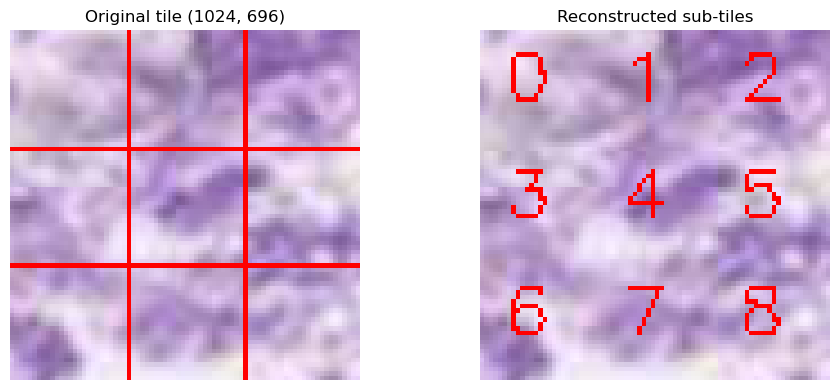

🧬 C1~C35 Expression Comparison:
Index         Original    SubTiles      Δ Diff
----------------------------------------
C1            -0.554     -0.554      0.000
C2             0.696      0.696      0.000
C3            -0.502     -0.502      0.000
C4            -0.410     -0.410      0.000
C5            -0.598     -0.598      0.000
C6            -0.406     -0.406      0.000
C7            -0.778     -0.778      0.000
C8            -0.273     -0.273      0.000
C9            -0.458     -0.458      0.000
C10           -0.394     -0.394      0.000
C11           -0.253     -0.253      0.000
C12           -0.769     -0.769      0.000
C13            0.845      0.845      0.000
C14            1.334      1.334      0.000
C15           -0.623     -0.623      0.000
C16           -0.718     -0.718      0.000
C17            2.842      2.842      0.000
C18           -0.644     -0.644      0.000
C19           -0.471     -0.471      0.000
C20           -0.725     -0.725      0.000
C21           -0.310

In [12]:
import random

# 隨機抽一筆資料（從全體 tiles 中）
i = random.randint(0, len(train_subtiles) - 1)

# 取對應的 sub-tiles 與 label
subtiles = train_subtiles[i]
label_tiles = train_labels[i]
slide_id, x, y = train_meta_info[i]  # 👈 slide 來源、spot 座標

# 從 HDF5 開檔案 → 抓對應 slide image
with h5py.File('../elucidata_ai_challenge_data.h5', 'r') as h5file:
    train_images = h5file['images/Train']
    image = train_images[slide_id][()]  # 👈 讀出 NumPy 陣列
    
# 找原始 label（可選）
row = train_spot_tables[slide_id]
row_match = row[(row['x'] == x) & (row['y'] == y)]
if len(row_match) == 0:
    print("⚠️ 找不到對應的 spot")
    label_gt = label_tiles  # fallback
else:
    label_gt = row_match.iloc[0].iloc[2:].values.astype(np.float32)

# 執行視覺化比對
print(f"Slides: {slide_id}")
compare_tile_and_label_visuals(image, x, y, subtiles, label_gt, label_tiles)


#### See whether the stribe window do it right

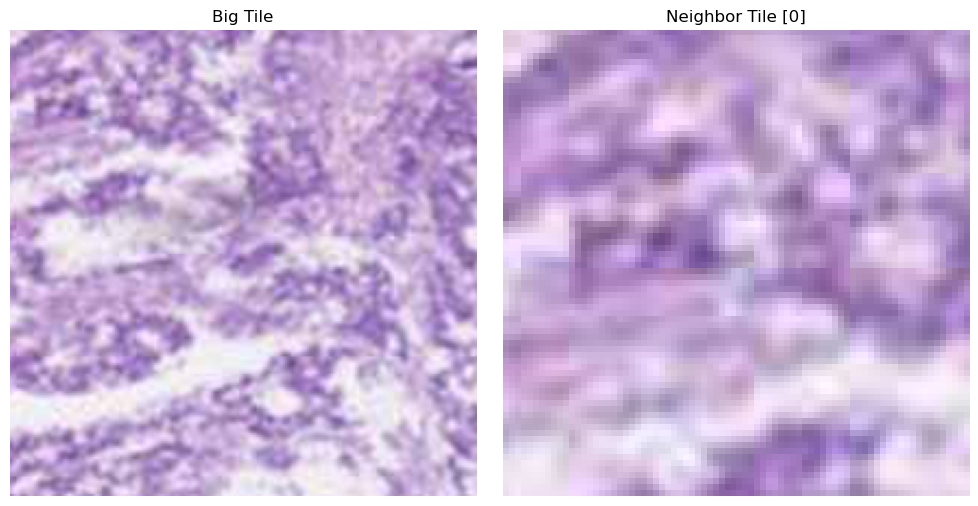

In [13]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# 左邊是大 tile
tile = extract_tile(image, x, y, tile_size=tile_size + stride*2)
axes[0].imshow(tile)
axes[0].set_title("Big Tile")
axes[0].axis("off")

# 右邊是某個 neighbor tile
negihbor_num = 0
neighbor_tile = train_neighbor_tiles[i][negihbor_num]
axes[1].imshow(neighbor_tile)
axes[1].set_title(f"Neighbor Tile [{negihbor_num}]")
axes[1].axis("off")

plt.tight_layout()
plt.show()


## Transfer into training dataset 

In [9]:
## Make sure I have all the data
total_spots = sum(len(df) for df in train_spot_tables.values())
print(f"Total number of spots across all slides: {total_spots}")

print(f"The spots in our preprocessing datasets: {len(train_M_tiles)}")

Total number of spots across all slides: 8181
The spots in our preprocessing datasets: 8181


In [ ]:
import h5py

with h5py.File("./dataset/final_data/log2_lable.h5", "w") as f:
    f.create_dataset("tiles", data=np.array(), compression="gzip")
    print("✅ Saved to HDF5!")


✅ Saved to HDF5!


In [115]:
import torch
import os

output_dir = "./dataset/final_data/"
#os.makedirs(output_dir, exist_ok=True)

# 轉換成 tensor（可選擇是否轉換）
#torch.save(all_L_tiles, os.path.join(output_dir, "L_tiles.pt"))
#torch.save(all_S_tiles, os.path.join(output_dir, "subtiles.pt"))
#torch.save(all_M_tiles, os.path.join(output_dir, "M_tiles.pt"))
torch.save(all_labels, os.path.join(output_dir, "gu_log2_labels.pt"))
#torch.save({
#    "coords": all_coords,
 #   "normalized_coords": all_normal_coords
#}, os.path.join(output_dir, "meta_info.pt"))

print("✅ 所有資料已成功儲存到 final_data 資料夾！")


✅ 所有資料已成功儲存到 final_data 資料夾！


In [17]:
train_meta_info

[('S_1', 1554, 1297),
 ('S_1', 462, 1502),
 ('S_1', 1488, 1548),
 ('S_1', 1725, 1182),
 ('S_1', 581, 1113),
 ('S_1', 765, 1342),
 ('S_1', 1304, 1640),
 ('S_1', 463, 998),
 ('S_1', 1252, 953),
 ('S_1', 1409, 1640),
 ('S_1', 1699, 679),
 ('S_1', 1094, 1182),
 ('S_1', 410, 815),
 ('S_1', 922, 1571),
 ('S_1', 936, 1410),
 ('S_1', 568, 1319),
 ('S_1', 410, 998),
 ('S_1', 1449, 1159),
 ('S_1', 1475, 1114),
 ('S_1', 1725, 862),
 ('S_1', 1120, 1228),
 ('S_1', 1251, 1365),
 ('S_1', 1356, 1640),
 ('S_1', 949, 1159),
 ('S_1', 1541, 1365),
 ('S_1', 1673, 633),
 ('S_1', 436, 1273),
 ('S_1', 884, 907),
 ('S_1', 976, 930),
 ('S_1', 1449, 747),
 ('S_1', 1725, 954),
 ('S_1', 620, 1410),
 ('S_1', 647, 1227),
 ('S_1', 765, 792),
 ('S_1', 699, 1548),
 ('S_1', 542, 815),
 ('S_1', 1435, 1319),
 ('S_1', 489, 1181),
 ('S_1', 620, 1502),
 ('S_1', 1699, 1274),
 ('S_1', 1515, 770),
 ('S_1', 896, 1616),
 ('S_1', 528, 975),
 ('S_1', 1698, 1457),
 ('S_1', 1475, 1068),
 ('S_1', 1422, 1205),
 ('S_1', 1291, 1571),
 ('

In [16]:
import torch

torch.save({
    'tiles': train_tiles,
    'subtiles': train_subtiles,
    'neighbor_tiles': train_neighbor_tiles,
    'labels': train_labels,
    'meta_info': train_meta_info
}, "train_dataset.pt")

: 

# Test data preparation

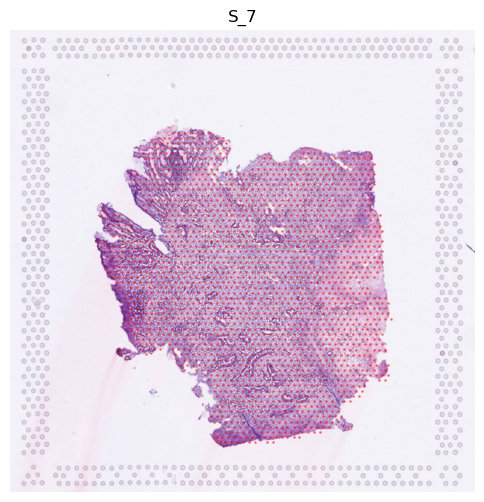

In [7]:
# Visualize Test slide ('S_7')
with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    test_images = h5file["images/Test"]
    test_spots = h5file["spots/Test"]
    
    sample = 'S_7'
    image = np.array(test_images[sample])
    spots = np.array(test_spots[sample])
    x, y = spots["x"], spots["y"]

    plt.figure(figsize=(6,6))
    plt.imshow(image, aspect="auto")
    plt.scatter(x, y, color="red", s=1, alpha=0.4)
    plt.axis('off')
    plt.title(sample)
    plt.show()

In [8]:
# Display spot table for Test slide (only the spot coordinates on 2D array)
with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as f:
    test_spots = f["spots/Test"]
    print(test_spots.keys())
    spot_array = np.array(test_spots['S_7'])
    test_spot_table = pd.DataFrame(spot_array)
    
# Show the test spots coordinates for slide 'S_7'
test_spot_table

<KeysViewHDF5 ['S_7']>


,x,y,Test_Set
0,1499,1260,2
1,1435,1503,2
2,558,1082,2
3,736,1304,1
4,1257,1592,1
...,...,...,...
2083,736,639,2
2084,1016,684,2
2085,1181,839,2
2086,735,1436,1


Found 17 spots in this tile.


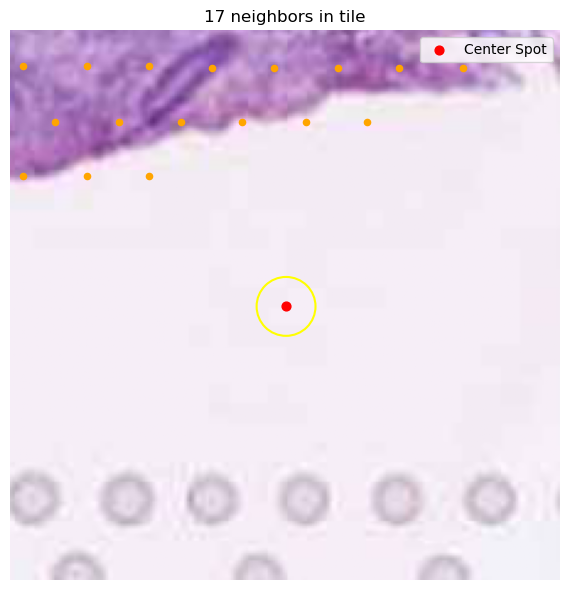

In [215]:
import random

# 隨機抽一筆資料（從全體 tiles 中）

i = random.randint(0, len(test_spot_table) - 1)

row = test_spot_table.iloc[i]

x = 1300
y = 1800

# 取得tile範圍內的spot們
neighbors_df = get_spots_in_tile(test_spot_table, x, y, tile_size=224)

print(f"Found {len(neighbors_df)} spots in this tile.")
#print(neighbors_df[['x', 'y']])
##print(x,y)
plot_tile_with_spots(
    slide_image=image,
    spot_df=neighbors_df,
    center_x=x,
    center_y=y,
    tile_size=224,
    #grid_size=3,
    spot_radius_px=12
)


In [26]:
coords = test_spot_table[['x', 'y']].values
# 計算距離矩陣（所有 spot 之間）
dist_matrix = squareform(pdist(coords))  # shape = (N, N)

# 把對角線設為無限大（自己對自己不算）
np.fill_diagonal(dist_matrix, np.inf)

# 取得每個 spot 最近的一個鄰居距離
min_dists = dist_matrix.min(axis=1)

# 算平均距離
mean_spacing = min_dists.mean()

print(f"平均每個 spot 間距：約 {mean_spacing:.2f} pixels")

平均每個 spot 間距：約 25.01 pixels


0.8490186


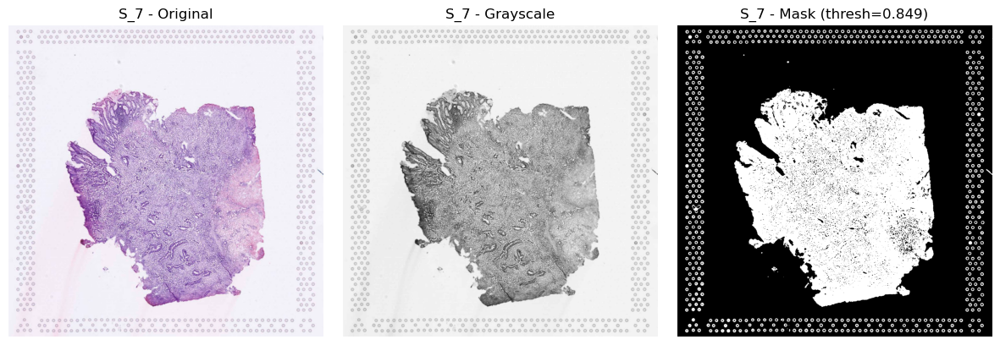

In [13]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import threshold_mean
custom_thresholds = {
    
}
slide_masks = {}
slide_thresholds = {}
slide ={}
with h5py.File("./dataset/elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Test"]
    slide_ids = list(train_images.keys())

    n = len(slide_ids)
    fig, axs = plt.subplots(nrows=n, ncols=3, figsize=(12, 4 * n))
    if n == 1:
        axs = [axs]

    for i, slide_id in enumerate(slide_ids):
        image = np.array(train_images[slide_id])
        gray_image = rgb2gray(image)

        # ✅ 使用自訂 threshold（如果沒有就 fallback）
        thresh = custom_thresholds.get(slide_id, threshold_mean(gray_image))
        binary_mask = (gray_image > thresh).astype(np.uint8)
        binary_mask = 1 - binary_mask
        print(thresh)
        slide[slide_id] = image
        slide_masks[slide_id] = binary_mask
        slide_thresholds[slide_id] = thresh

        axs[i][0].imshow(image)
        axs[i][0].set_title(f"{slide_id} - Original")
        axs[i][0].axis("off")

        axs[i][1].imshow(gray_image, cmap="gray")
        axs[i][1].set_title(f"{slide_id} - Grayscale")
        axs[i][1].axis("off")

        axs[i][2].imshow(binary_mask, cmap="gray")
        axs[i][2].set_title(f"{slide_id} - Mask (thresh={thresh:.3f})")
        axs[i][2].axis("off")

    plt.tight_layout()
    plt.show()



✔️ 合併完成: S_7 → shape (1983, 2000, 4)


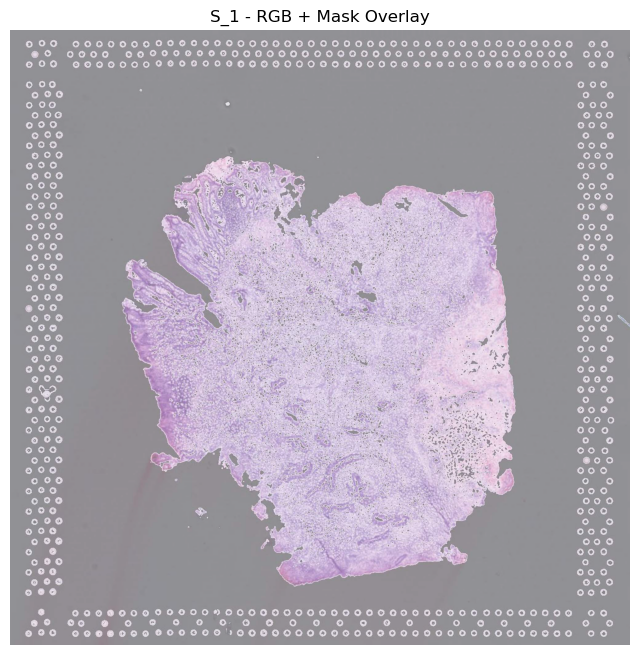

In [16]:
combined_slide_images = {}  # slide_id -> (H, W, 4)

for slide_id in slide.keys():
    image = slide[slide_id]                  # shape: (H, W, 3)
    mask = slide_masks[slide_id]         # shape: (H, W)

    # ✅ 先把 mask 加一個通道軸，變成 (H, W, 1)
    mask = np.expand_dims(mask, axis=-1)

    # ✅ 合併成 (H, W, 4)
    combined = np.concatenate([image, mask], axis=-1)  # 如果想讓 mask 是 0/255 表示可視化

    combined_slide_images[slide_id] = combined
    print(f"✔️ 合併完成: {slide_id} → shape {combined.shape}")
plt.figure(figsize=(8, 8))
plt.imshow(combined_slide_images['S_7'][:, :, :3])  # RGB
plt.imshow(combined_slide_images['S_7'][:, :, 3], cmap='gray', alpha=0.4)  # Mask 疊加
plt.title("S_1 - RGB + Mask Overlay")
plt.axis('off')
plt.show()


In [17]:
import h5py
import numpy as np

output_path = "./dataset/combined_slide_images_with_mask_test.h5"

with h5py.File(output_path, "w") as f:
    image_group = f.create_group("images/Test")

    for slide_id, combined_img in combined_slide_images.items():
        image_group.create_dataset(slide_id, data=combined_img)
        print(f"✔️ 已儲存 {slide_id} → shape {combined_img.shape}")

print(f"\n✅ 所有圖像+mask 已儲存到：{output_path}")


✔️ 已儲存 S_7 → shape (1983, 2000, 4)

✅ 所有圖像+mask 已儲存到：./dataset/combined_slide_images_with_mask_test.h5


In [18]:

test_S_tiles = []
test_M_tiles = []
test_L_tiles = []
normal_coords = []
coords = []

with h5py.File("./dataset/combined_slide_images_with_mask_test.h5", "r") as h5file:
    test_images = h5file["images/Test"]
    
    slide_ids = list(test_images.keys())  # e.g., only ['S_7']
    # Step 4: 標準化座標
    df = test_spot_table

    ext_coords = df[['x', 'y']].values
    scaler = MinMaxScaler()
    coords_normalized = scaler.fit_transform(ext_coords)
    df[['x_normalized', 'y_normalized']] = coords_normalized
    
    for slide_id in slide_ids:
        image = test_images[slide_id][()]  # 讀出唯一一張 test image

        for i, row in df.iterrows():
            x, y = int(row['x']), int(row['y'])
            nx, ny = row['x_normalized'], row['y_normalized']

            # 擷取 tile
            test_S_tile = extract_tile(image, x, y, tile_size=32)
            test_M_tile = extract_tile(image, x, y, tile_size=112)
            test_L_tile = extract_tile(image, x, y, tile_size=224)
            label = row.iloc[2:-2].values.astype(np.float32)

            # 儲存
            #test_S_tiles.append(test_S_tile)
            test_M_tiles.append(test_M_tile)
            #test_L_tiles.append(test_L_tile)
            coords.append((x, y))
            normal_coords.append((nx, ny))


In [20]:

import torch
import os
output_dir = "./dataset/final_data/"
os.makedirs(output_dir, exist_ok=True)

torch.save({
    'M_tiles': test_M_tiles,
    "coords": coords,
    "normalized_coords": normal_coords
}, os.path.join(output_dir, "test_dataset.pt"))



print("✅ 所有資料已成功儲存到 final_data 資料夾！")


✅ 所有資料已成功儲存到 final_data 資料夾！


In [ ]:
import h5py
import numpy as np

test_tiles = []
test_subtiles = []
test_labels = []
test_neighbor_tiles = []
test_meta_info = []

stride = 68

with h5py.File("./elucidata_ai_challenge_data.h5", "r") as h5file:
    train_images = h5file["images/Train"]
    slide_ids = list(train_spot_tables.keys())

    for slide_id in slide_ids:
        if slide_id not in train_images:
            print(f"⚠️ Slide {slide_id} not found in HDF5, skipping.")
            continue

        image = train_images[slide_id][()]  # H x W x 3
        df = train_spot_tables[slide_id]

        for i, row in df.iterrows():
            x, y = int(row['x']), int(row['y'])

            tile = extract_tile(image, x, y, tile_size=tile_size)
            subtiles = split_into_subtiles(tile, grid_size=3)
            neighbor_tiles = extract_neighbor_tiles_by_stride(image, x, y, tile_size, stride)

            label = row.iloc[2:].values.astype(np.float32)

            train_tiles.append(tile)
            train_subtiles.append(subtiles)
            train_neighbor_tiles.append(neighbor_tiles)  # ✅ 存入
            train_labels.append(label)
            train_meta_info.append((slide_id, x, y))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


Slides: S_7


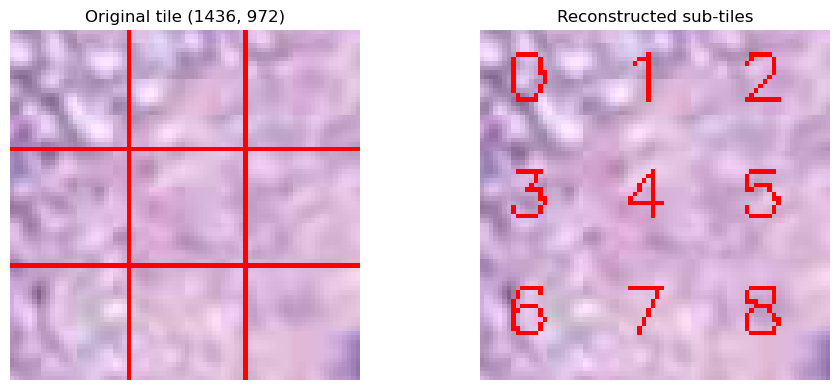

In [35]:
import random

# 隨機抽一筆資料（從全體 tiles 中）
i = random.randint(0, len(test_subtiles) - 1)

# 取對應的 sub-tiles 與 label
subtiles = test_subtiles[i]
label_tiles = test_labels[i]
slide_id, x, y = test_meta_info[i]  # 👈 slide 來源、spot 座標

with h5py.File('./elucidata_ai_challenge_data.h5', 'r') as h5file:
    test_images = h5file['images/Test']
    image = test_images[slide_id][()]
    
# 找原始 label（可選）
row_match = test_spot_table[(test_spot_table['x'] == x) & (test_spot_table['y'] == y)]

if len(row_match) == 0:
    print("⚠️ 找不到對應的 spot")
    label_gt = label_tiles  # fallback
else:
    label_gt = row_match.iloc[0].iloc[2:].values.astype(np.float32)

# 執行視覺化比對
print(f"Slides: {slide_id}")
compare_tile_and_label_visuals(image, x, y, subtiles)


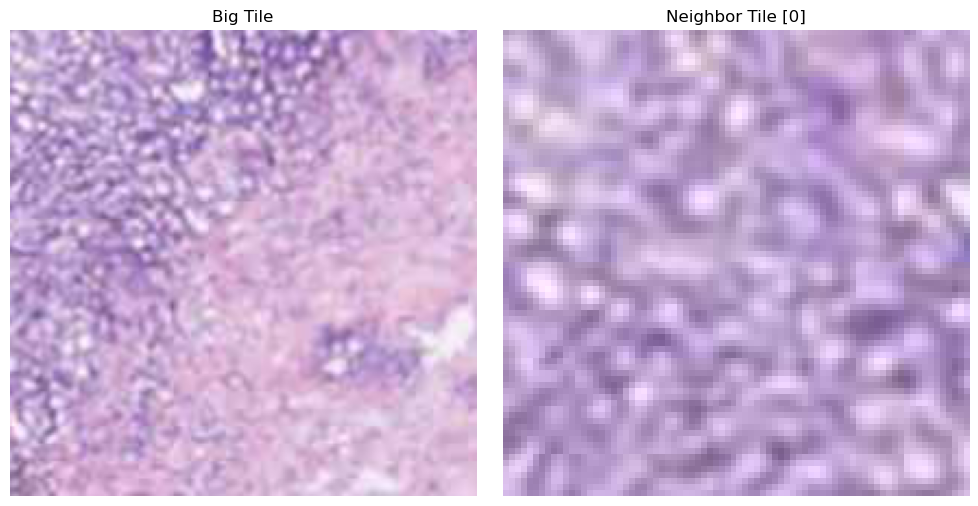

In [36]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# 左邊是大 tile
tile = extract_tile(image, x, y, tile_size=tile_size + stride*2)
axes[0].imshow(tile)
axes[0].set_title("Big Tile")
axes[0].axis("off")

# 右邊是某個 neighbor tile
negihbor_num = 0
neighbor_tile = test_neighbor_tiles[i][negihbor_num]
axes[1].imshow(neighbor_tile)
axes[1].set_title(f"Neighbor Tile [{negihbor_num}]")
axes[1].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
## Make sure I have all the data     

print(f"Total number of spots across all slides: {len(test_spot_table)}")

print(f"The spots in our preprocessing datasets: {len(test_tiles)}")

Total number of spots across all slides: 2088
The spots in our preprocessing datasets: 2088


In [37]:
torch.save({
    'tiles': test_tiles,
    'subtiles': test_subtiles,
    'neighbor_tiles': test_neighbor_tiles,
    'labels': test_labels,
    'meta_info': test_meta_info
}, "test_dataset.pt")